# House Price Forecasting in King Country
#### The work team : Samar, Yahia, Osama


## Data Collecting

In [ ]:
#Import Libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
from datetime import datetime
from pandas_profiling import ProfileReport
import scipy.stats as stats
from sklearn.feature_selection import SelectKBest, mutual_info_regression
from sklearn.ensemble import RandomForestRegressor
from sklearn.feature_selection import SelectFromModel
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import accuracy_score
from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score
from sklearn.metrics import mean_squared_error
from sklearn import metrics
from sklearn.linear_model import LinearRegression
from xgboost import XGBRegressor
from sklearn.decomposition import FastICA
from sklearn.preprocessing import MinMaxScaler
import pickle

In [2]:
pip install xgboost

In [3]:
pip install pgeocode

Note: you may need to restart the kernel to use updated packages.


In [4]:
# Read the CSV File Using Pandas read_csv function

df = pd.read_csv("kc_house_data.csv")
#Print the first 5 rows of the dataset
df.head()

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,7129300520,20141013T000000,221900.0,3,1.00,1180,5650,1.0,0,0,...,7,1180,0,1955,0,98178,47.5112,-122.257,1340,5650
1,6414100192,20141209T000000,538000.0,3,2.25,2570,7242,2.0,0,0,...,7,2170,400,1951,1991,98125,47.7210,-122.319,1690,7639
2,5631500400,20150225T000000,180000.0,2,1.00,770,10000,1.0,0,0,...,6,770,0,1933,0,98028,47.7379,-122.233,2720,8062
3,2487200875,20141209T000000,604000.0,4,3.00,1960,5000,1.0,0,0,...,7,1050,910,1965,0,98136,47.5208,-122.393,1360,5000
4,1954400510,20150218T000000,510000.0,3,2.00,1680,8080,1.0,0,0,...,8,1680,0,1987,0,98074,47.6168,-122.045,1800,7503


## Data Exploratory

In [5]:
#Print the summary of the dataset including the columns names , data type and count of non-null values for each coulmn
df.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21613 entries, 0 to 21612
Data columns (total 21 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   id             21613 non-null  int64  
 1   date           21613 non-null  object 
 2   price          21613 non-null  float64
 3   bedrooms       21613 non-null  int64  
 4   bathrooms      21613 non-null  float64
 5   sqft_living    21613 non-null  int64  
 6   sqft_lot       21613 non-null  int64  
 7   floors         21613 non-null  float64
 8   waterfront     21613 non-null  int64  
 9   view           21613 non-null  int64  
 10  condition      21613 non-null  int64  
 11  grade          21613 non-null  int64  
 12  sqft_above     21613 non-null  int64  
 13  sqft_basement  21613 non-null  int64  
 14  yr_built       21613 non-null  int64  
 15  yr_renovated   21613 non-null  int64  
 16  zipcode        21613 non-null  int64  
 17  lat            21613 non-null  float64
 18  long  

In [6]:
#Print how many rows and columns in the dataset 'befor the data cleaning'
df.shape


(21613, 21)

In [7]:
#Show some statistics related to the data frame columns
df.describe()


,id,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
count,2.161300e+04,2.161300e+04,21613.000000,21613.000000,21613.000000,2.161300e+04,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000
mean,4.580302e+09,5.400881e+05,3.370842,2.114757,2079.899736,1.510697e+04,1.494309,0.007542,0.234303,3.409430,7.656873,1788.390691,291.509045,1971.005136,84.402258,98077.939805,47.560053,-122.213896,1986.552492,12768.455652
std,2.876566e+09,3.671272e+05,0.930062,0.770163,918.440897,4.142051e+04,0.539989,0.086517,0.766318,0.650743,1.175459,828.090978,442.575043,29.373411,401.679240,53.505026,0.138564,0.140828,685.391304,27304.179631
min,1.000102e+06,7.500000e+04,0.000000,0.000000,290.000000,5.200000e+02,1.000000,0.000000,0.000000,1.000000,1.000000,290.000000,0.000000,1900.000000,0.000000,98001.000000,47.155900,-122.519000,399.000000,651.000000
25%,2.123049e+09,3.219500e+05,3.000000,1.750000,1427.000000,5.040000e+03,1.000000,0.000000,0.000000,3.000000,7.000000,1190.000000,0.000000,1951.000000,0.000000,98033.000000,47.471000,-122.328000,1490.000000,5100.000000
50%,3.904930e+09,4.500000e+05,3.000000,2.250000,1910.000000,7.618000e+03,1.500000,0.000000,0.000000,3.000000,7.000000,1560.000000,0.000000,1975.000000,0.000000,98065.000000,47.571800,-122.230000,1840.000000,7620.000000
75%,7.308900e+09,6.450000e+05,4.000000,2.500000,2550.000000,1.068800e+04,2.000000,0.000000,0.000000,4.000000,8.000000,2210.000000,560.000000,1997.000000,0.000000,98118.000000,47.678000,-122.125000,2360.000000,10083.000000
max,9.900000e+09,7.700000e+06,33.000000,8.000000,13540.000000,1.651359e+06,3.500000,1.000000,4.000000,5.000000,13.000000,9410.000000,4820.000000,2015.000000,2015.000000,98199.000000,47.777600,-121.315000,6210.000000,871200.000000


In [8]:
df.isnull().sum()
# no missing values

id               0
date             0
price            0
bedrooms         0
bathrooms        0
sqft_living      0
sqft_lot         0
floors           0
waterfront       0
view             0
condition        0
grade            0
sqft_above       0
sqft_basement    0
yr_built         0
yr_renovated     0
zipcode          0
lat              0
long             0
sqft_living15    0
sqft_lot15       0
dtype: int64

In [9]:
#Print how many duplicated value in the dataset
sum(df.duplicated())


0

Our dataset is very clean

In [10]:
# show our dataset details in an advance way
profile = ProfileReport(df, title="House Pricing")
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

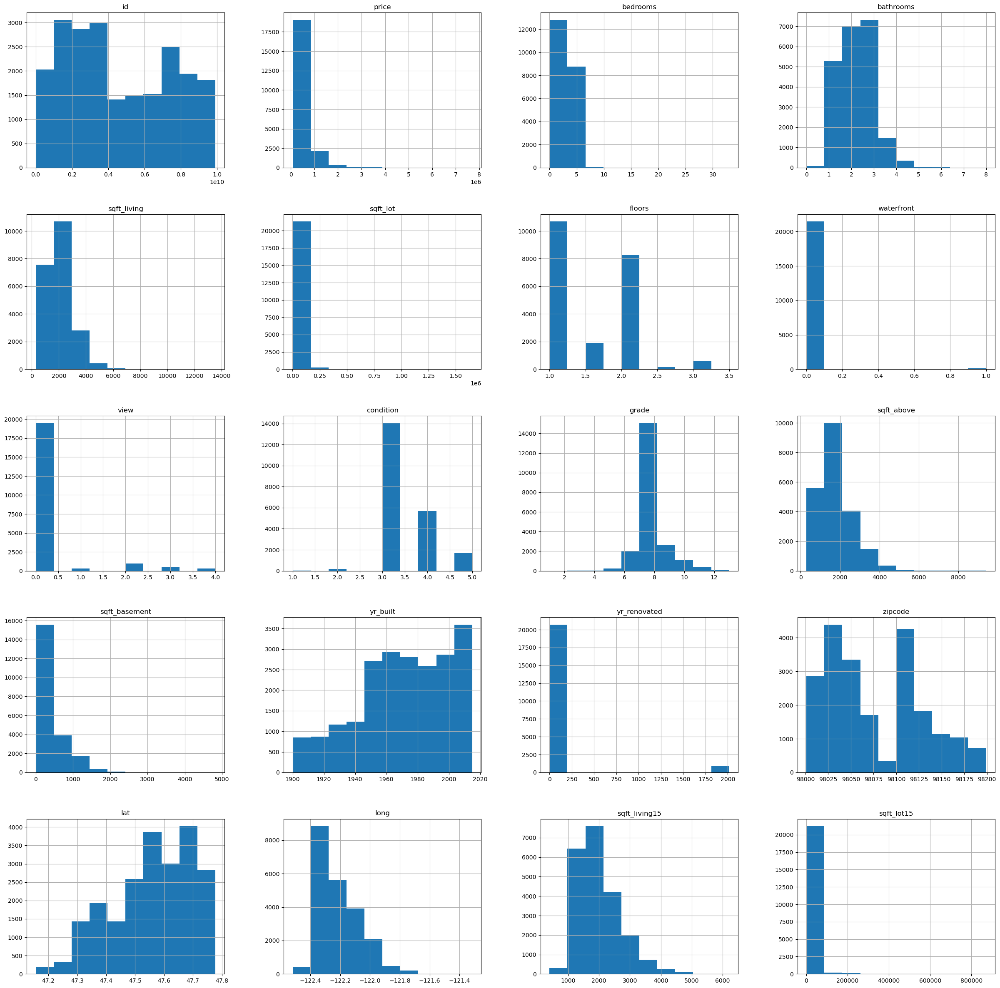

In [11]:
# let's see the frequency of our features
df.hist(figsize = (30,30))
plt.show()

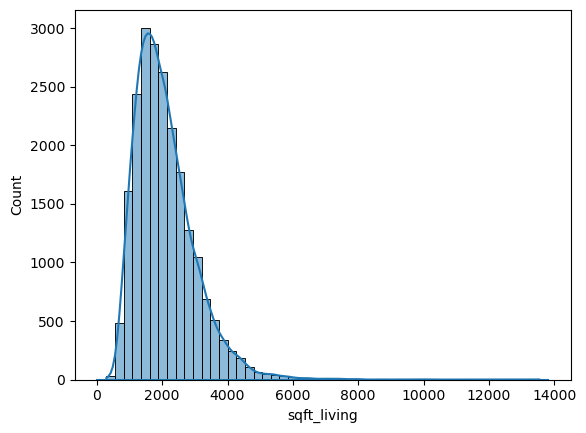

In [12]:
def feature_frequency_plotter(feature_name, bins_num):
    sns.histplot(df[feature_name], bins=bins_num, kde=True, fill=True)
    sns.kdeplot(df[feature_name], bw_method=0.1)
feature_frequency_plotter('sqft_living',50)  

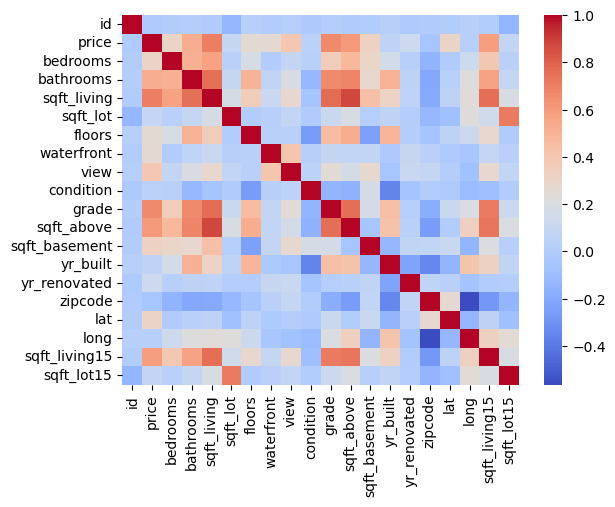

In [13]:
# see the correlations between our features

sns.heatmap(df.corr(), annot=False, cmap='coolwarm')
plt.show()

depends on the correlation between the target (price) and the other features, let's see the graphs of the most important features


## Data Cleaning

firstly we need to reformulate the date column, and maybe we will axtract some features from it.
no need for data cleaning of missing values or duplicates, but we need to drop some features 


In [14]:
# reformulate date column 
df['date'] = pd.to_datetime(df['date']) 
df['month'] = df['date'].apply(lambda date:date.month) #for a new column (month)
df['year'] = df['date'].apply(lambda date:date.year) #for a new column (year)
df.head()

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,month,year
0,7129300520,2014-10-13,221900.0,3,1.00,1180,5650,1.0,0,0,...,0,1955,0,98178,47.5112,-122.257,1340,5650,10,2014
1,6414100192,2014-12-09,538000.0,3,2.25,2570,7242,2.0,0,0,...,400,1951,1991,98125,47.7210,-122.319,1690,7639,12,2014
2,5631500400,2015-02-25,180000.0,2,1.00,770,10000,1.0,0,0,...,0,1933,0,98028,47.7379,-122.233,2720,8062,2,2015
3,2487200875,2014-12-09,604000.0,4,3.00,1960,5000,1.0,0,0,...,910,1965,0,98136,47.5208,-122.393,1360,5000,12,2014
4,1954400510,2015-02-18,510000.0,3,2.00,1680,8080,1.0,0,0,...,0,1987,0,98074,47.6168,-122.045,1800,7503,2,2015


In [15]:
#now we are dropping the unneeded columns (id,zipcode,date); including "date" after axtracting two columns from it
df  = df.drop(['date','id','zipcode'],axis=1)
df.shape
# the shape has been changed

(21613, 20)

In [16]:

def feature_count_plotter(feature_name,xticks_rotation=0):
    df[feature_name].value_counts().sort_index().plot.bar()

# Set labels and title
    plt.xlabel(feature_name)
    plt.ylabel('Count')
    plt.title('Number of ' + feature_name)
    plt.xticks(rotation=xticks_rotation)

    # Display the plot
    plt.show()
    


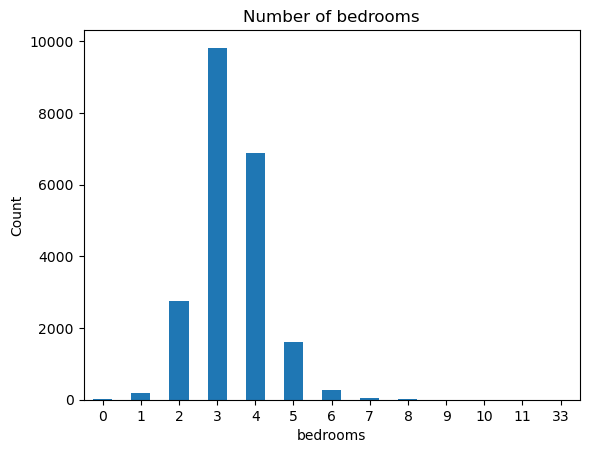

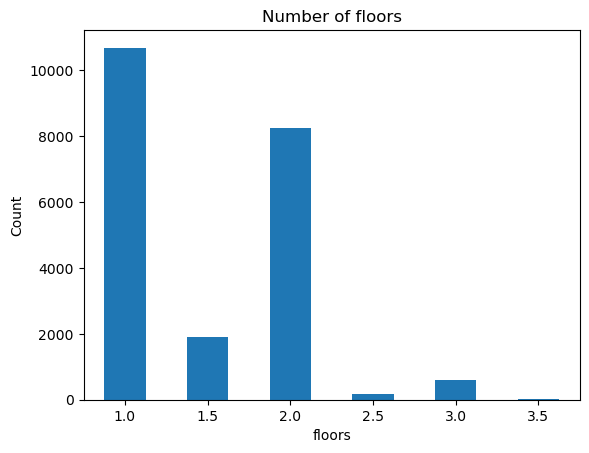

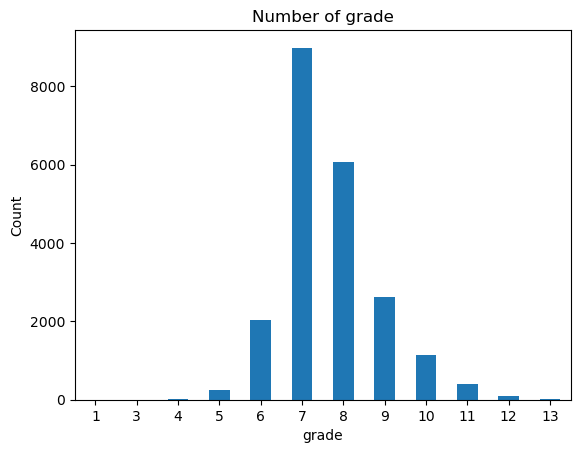

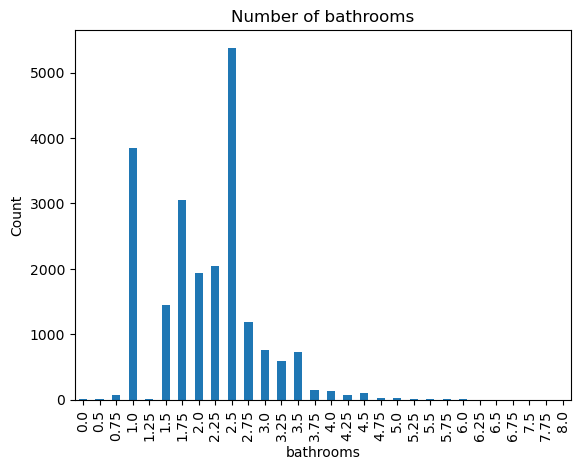

In [17]:
feature_count_plotter('bedrooms')
feature_count_plotter('floors')
feature_count_plotter('grade')
feature_count_plotter('bathrooms',90)

In [18]:
def feature_boxplot(feature_name):
  
    fig, ax = plt.subplots(figsize=(8, 6))

    ax.boxplot(df[feature_name])

    # Set labels and title
    ax.set_xlabel(feature_name)
    ax.set_ylabel('Count')
    ax.set_title('Box Plot of '+ feature_name)
    #ax.set_yticks(range(0, max(df[feature_name])+2.0, 2))
  
    # Display the plot
    plt.show()
    

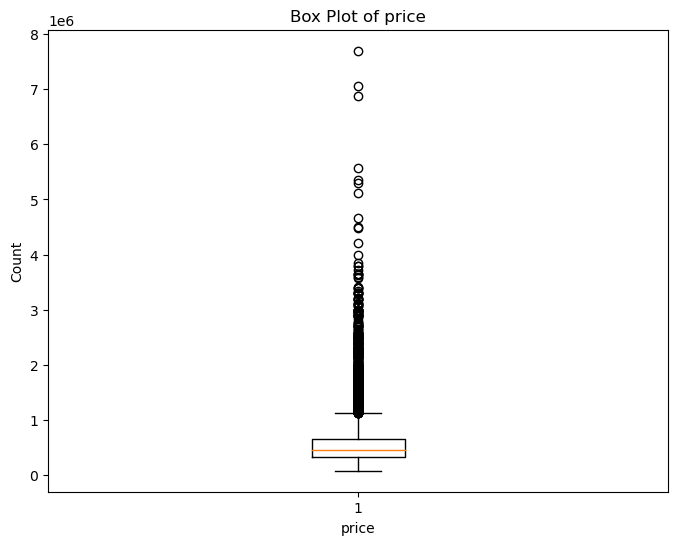

In [19]:
feature_boxplot('price')

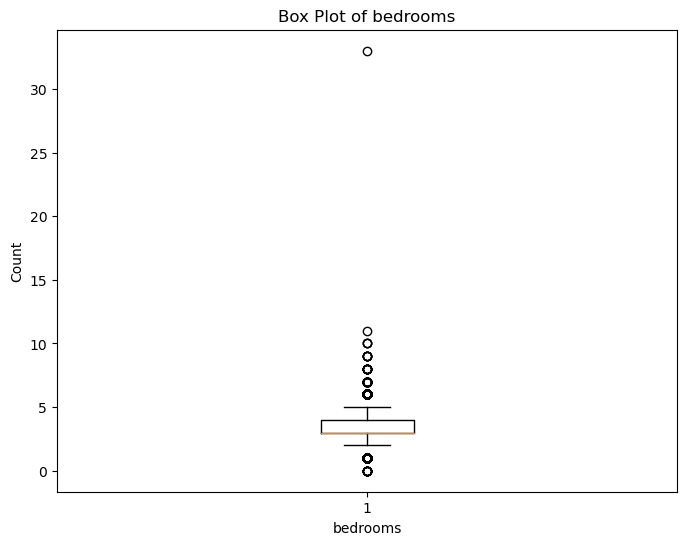

In [20]:
feature_boxplot('bedrooms')

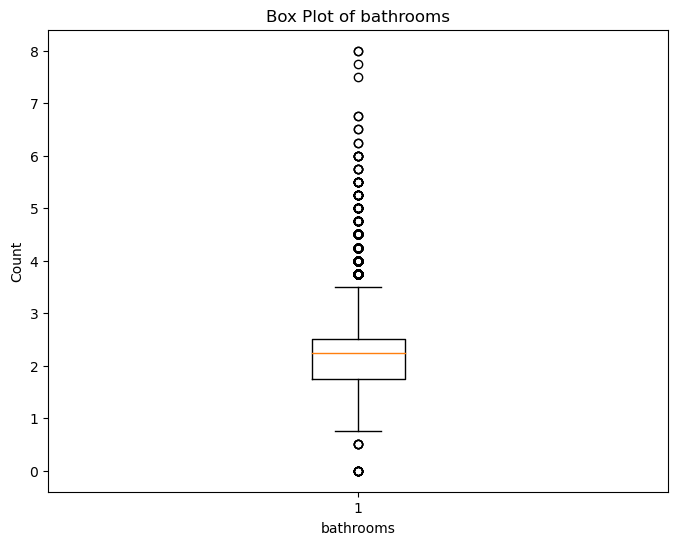

In [21]:
feature_boxplot('bathrooms')

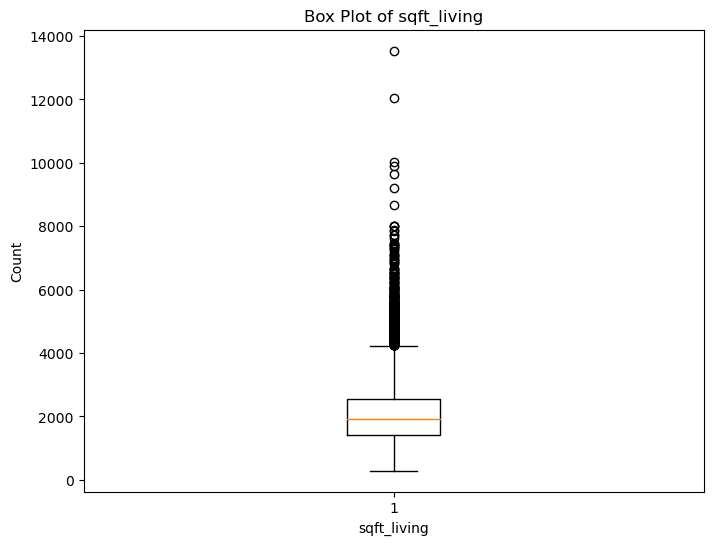

In [22]:
feature_boxplot('sqft_living')

## Univariate visualization and analysis

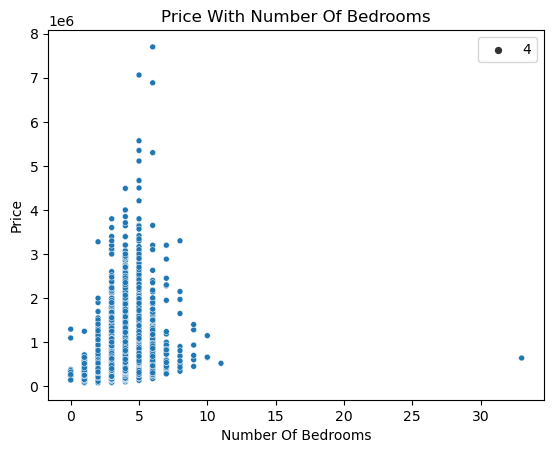

In [23]:
sns.scatterplot(x='bedrooms',y='price',data=df,size=4)
plt.xlabel("Number Of Bedrooms")
plt.ylabel("Price")
plt.title("Price With Number Of Bedrooms")
plt.show()

Note that when the houses have number of bedrooms in range (4-6), the range of price increases. But the expected was not correct, there is no strong relationship between number of bedrooms and price.

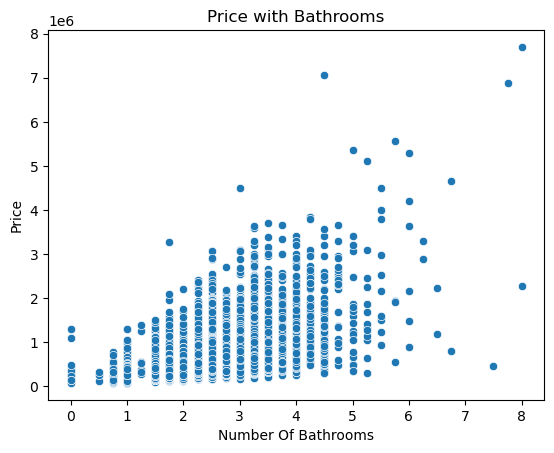

In [24]:
sns.scatterplot(data=df, x="bathrooms", y="price")
plt.xlabel("Number Of Bathrooms")
plt.ylabel("Price")
plt.title("Price with Bathrooms")
plt.show()

postive relationship too

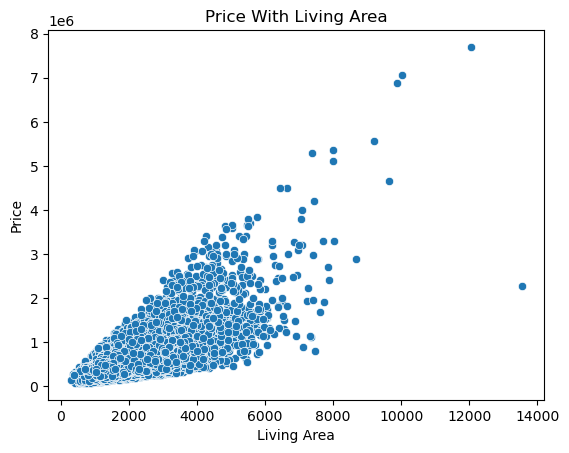

In [25]:
sns.scatterplot(data=df, x="sqft_living", y="price")
plt.xlabel("Living Area")
plt.ylabel("Price")
plt.title("Price With Living Area")
plt.show()

note that the relationship between the target (price) and the area of living is somehow a positive relationship

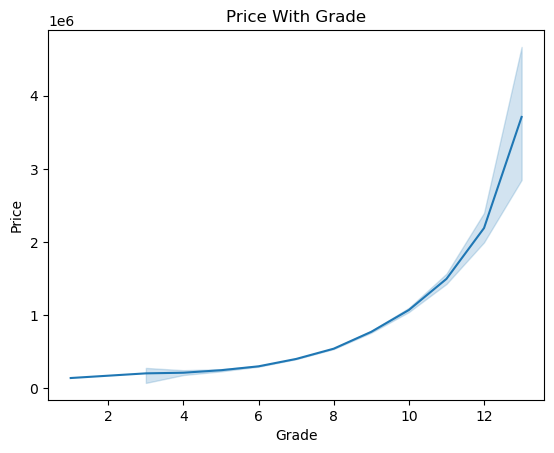

In [26]:
sns.lineplot(data=df, x="grade", y="price")
plt.xlabel("Grade")
plt.ylabel("Price")
plt.title("Price With Grade")
plt.show()

it seems that the distribution is uniform, but obviously the price increases when the garde increased

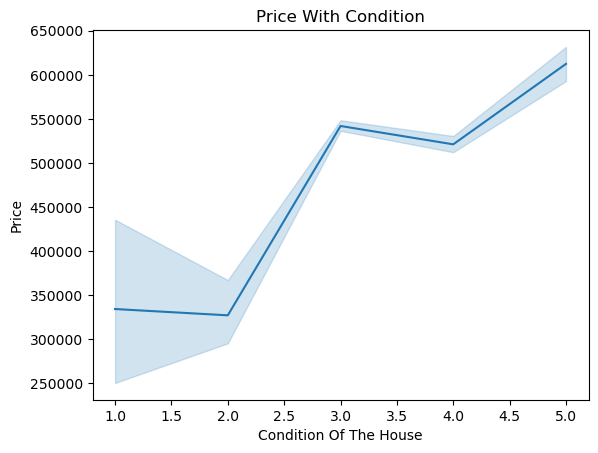

In [27]:
sns.lineplot(data=df, x="condition", y="price")
plt.xlabel("Condition Of The House")
plt.ylabel("Price")
plt.title("Price With Condition")
plt.show()

it gives us indication that the condition affects the price strongly (positivly)

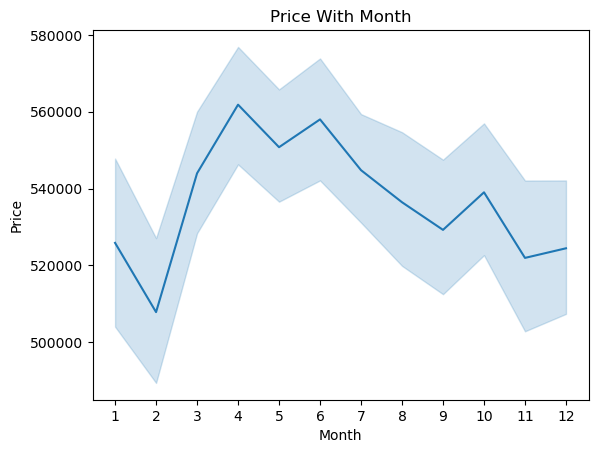

In [28]:
sns.lineplot(data=df, x="month", y="price")
plt.xlabel("Month")
plt.ylabel("Price")
plt.title("Price With Month")
plt.xticks([1,2,3,4,5,6,7,8,9,10,11,12])
plt.show()

That may tell us what is our first hypothosis (monthly price cycle). But to give a good insight, we need more than one year data.

###### Let's see the built year effect on the price (indication for another hypothesis)


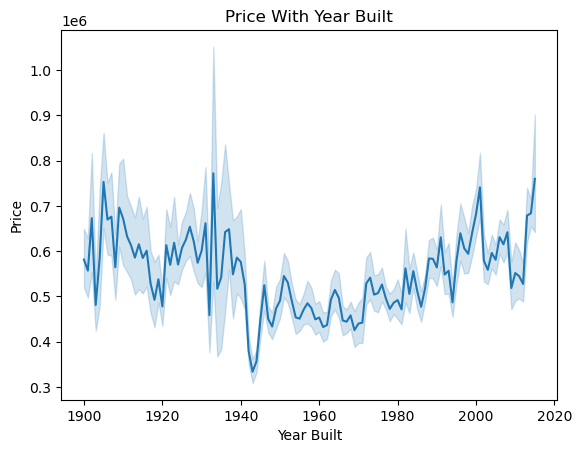

In [32]:
sns.lineplot(data=df, x="yr_built", y="price")
plt.xlabel("Year Built")
plt.ylabel("Price")
plt.title("Price With Year Built")
plt.show()

Expected that the year has a big effect, It seems that it does not. (another hypothesis to see)

## Hypothesis building 

The ideas came from the noted graphs, we discussed above.

We will discuss three hypothesis

In [33]:
# Perform Pearson correlation test for lat and house prices
def pvalue_hypothesis_test(feature1,feature2):
   
    correlation,p_value = stats.pearsonr(df[feature1], df[feature2])
    #print("Correlation coefficient ("+ feature1 +" vs "+ feature2+"):" , correlation)
    print("P-value ("+ feature1 +" vs "+ feature2+"):" , p_value)
    # Set the significance level
    alpha = 0.05

    # Check if the p-values are less than the significance level
    if p_value < alpha:
        print("Reject H0 " )
    else:
        print("Cannot reject H0 " )

- The first Hypothesis :

In [35]:
# The null and alternative hypthesis

"""
   H0: Location(lat,long) have  no Effect on House Prices 

   H1: Location(lat,long) have  Effect on House Prices
   alpha = 0.05
"""

pvalue_hypothesis_test("lat","price")
pvalue_hypothesis_test("long","price")


P-value (lat vs price): 0.0
Reject H0 
P-value (long vs price): 0.0014750922063326644
Reject H0 


- The second Hypothesis :

In [36]:
"""
   H0: The earlier bult date of the house result in the lower house price
   H1: The earlier built date of the house not result in the lower house price
"""

pvalue_hypothesis_test("yr_built","price")

P-value (yr_built vs price): 1.929872809396617e-15
Reject H0 


- The third Hypothesis :

In [37]:
"""
   H0: Average Price of houses is not affected by month
   H1: Average Price of houses have effect by month 
"""


'\n   H0: Average Price of houses is not affected by month\n   H1: Average Price of houses have effect by month \n'

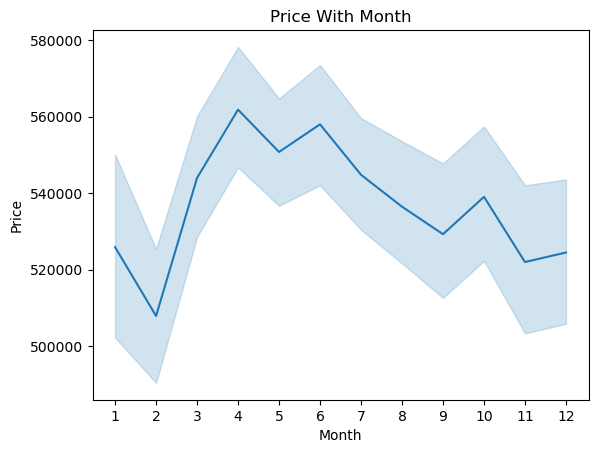

In [38]:
sns.lineplot(data=df, x="month", y="price")
plt.xlabel("Month")
plt.ylabel("Price")
plt.title("Price With Month")
plt.xticks([1,2,3,4,5,6,7,8,9,10,11,12])
plt.show()

As the graph show, the month effects average price of sold houses.
Befor summer season the prices increase significantly, then they starts to decrease moderately.

## Feature Selection


In [40]:
#split dataset
X = df.drop(['price'],axis=1) 
y = df['price'] 

#### Standardize features that need scaling

In [41]:
def scale_feature(scaler,df,feature):
    df[feature] = scaler.fit_transform(df[[feature]])
    

In [42]:
scaler = MinMaxScaler()
scale_feature(scaler,X,'sqft_living')
scale_feature(scaler,X,'sqft_lot')
scale_feature(scaler,X,'sqft_above')
scale_feature(scaler,X,'sqft_basement')
scale_feature(scaler,X,'sqft_living15')
scale_feature(scaler,X,'sqft_lot15')

- The first feature selection is Mutual Information:

In [64]:

# Split the data into training and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=77)
np.random.seed(123)
# Feature selection using mutual information
selector = SelectKBest(mutual_info_regression, k=16)
X_train_selected = selector.fit_transform(X_train, y_train)
X_test_selected = selector.transform(X_test)

selected_feature_indices = selector.get_support(indices=True)
selected_features = X.columns[selected_feature_indices]
print("Selected Features: \n" ,selected_features )

Selected Features: 
 Index(['bedrooms', 'bathrooms', 'sqft_living', 'sqft_lot', 'floors',
       'waterfront', 'view', 'condition', 'grade', 'sqft_above',
       'sqft_basement', 'yr_built', 'lat', 'long', 'sqft_living15',
       'sqft_lot15'],
      dtype='object')


Just like the expected (sqft_living  ,grade  ,lat  ,sqft_living15  ,sqft_above ,bathrooms  ) are the most importent features


- The secound feature selection is Random Forest Regressor:

In [65]:
# X = df.drop(['price'], axis=1)  # Features
# y = df['price']  # Target variable

rf = RandomForestRegressor()
rf.fit(X, y)

selector = SelectFromModel(rf, prefit=True)
X_selected = selector.transform(X)

feature_indices = selector.get_support(indices=True)
selected_features = X.columns[feature_indices]


print("Selected Features: \n" ,selected_features )
print("Random Forest:",rf.score(X,y))

C:\Users\Hello\anaconda3\lib\site-packages\sklearn\base.py:443: UserWarning: X has feature names, but SelectFromModel was fitted without feature names
  warnings.warn(


Selected Features: 
 Index(['sqft_living', 'grade', 'lat', 'long'], dtype='object')
Random Forest: 0.9835902157186672


The most importent features in Random Forest Regressor are (sqft_living ,grade ,lat ,sqft_living15 ,sqft_above ,bathrooms ).  

## Machine Learning models 


In [54]:
class Model:
    def __init__(self,model,Xtrain,Ytrain,Xtest,Ytest):
        self.model_name = ""
        self.trained = False
        self.model = model
        self.Xtrain = Xtrain
        self.Xtest = Xtest
        self.Ytrain = Ytrain
        self.Ytest = Ytest
        self.Ypred = 0

    def train(self):
        print("Training the model...")
        self.model.fit(self.Xtrain,self.Ytrain)
        self.trained = True

    def predict(self):
        if not self.trained:
            raise ValueError("Model has not been trained yet.")
        
        # Implementation for making predictions using the trained model
        print("Making predictions...")
        # Your prediction logic goes here
        self.Ypred = self.model.predict(self.Xtest)
        return self.Ypred

    def evaluate_rmse(self):
        if not self.trained:
            raise ValueError("Model has not been trained yet.")

        # Implementation for evaluating the model's performance
        # Your evaluation logic goes here
        rmse=np.sqrt(metrics.mean_squared_error(self.Ytest, self.Ypred))
        print("Root Mean Square Error:",rmse)
        return rmse

    def evaluate_r2(self):
        if not self.trained:
            raise ValueError("Model has not been trained yet.")

        # Implementation for evaluating the model's performance
        print("r2 Score :",r2_score(self.Ytest, self.Ypred))
        # Your evaluation logic goes here
        return r2_score(self.Ytest, self.Ypred)
    
    def plot_model(self):
        plt.scatter(self.Ytest, self.Ypred, color='blue', alpha=0.5)
        plt.plot([min(self.Ytest), max(self.Ytest)], [min(self.Ytest), max(self.Ytest)], color='red', linestyle='--')
        plt.xlabel('Actual Values')
        plt.ylabel('Predicted Values')
        plt.title('Predicted vs. Actual')
        plt.show()
    

##### 1. Linear Regression Model

In [66]:
linear1 = Model(LinearRegression(),X_train_selected, y_train,X_test_selected,y_test)
linear1.train()
linear1.predict()
linear1.evaluate_rmse()
linear1.evaluate_r2()
#linear1.plot_model()

Training the model...
Making predictions...
Root Mean Square Error: 204961.84618000162
r2 Score : 0.6988435348815953


0.6988435348815953

##### 2. Random Forest Regression 

In [67]:
Random1 = Model(RandomForestRegressor(),X_train_selected, y_train,X_test_selected,y_test)
Random1.train()
Random1.predict()
Random1.evaluate_rmse()
Random1.evaluate_r2()
#Random1.plot_model()

Training the model...
Making predictions...
Root Mean Square Error: 134872.5047713172
r2 Score : 0.8695953768693249


0.8695953768693249

##### 3. XGBoost Regression

In [68]:
XGB1 = Model(XGBRegressor(),X_train_selected, y_train,X_test_selected,y_test)
XGB1.train()
XGB1.predict()
XGB1.evaluate_rmse()
XGB1.evaluate_r2()
#XGB1.plot_model()


Training the model...
Making predictions...
Root Mean Square Error: 125312.33729539631
r2 Score : 0.8874271132214842


0.8874271132214842

#### PCA for dimensionality reduction

In [69]:
# Apply PCA for dimensionality reduction
pca = PCA(n_components=10)
X_train_pca = pca.fit_transform(X_train_selected)
X_test_pca = pca.transform(X_test_selected)

##### Random Forest Regressor after PCA

In [70]:
random2 = Model(RandomForestRegressor(),X_train_pca, y_train,X_test_pca,y_test)
random2.train()
random2.predict()
random2.evaluate_rmse()
random2.evaluate_r2()
#random2.plot_model()


Training the model...
Making predictions...
Root Mean Square Error: 182934.97526884748
r2 Score : 0.7600948150170593


0.7600948150170593

##### XGBoost Regression after PCA 

In [71]:
XGB2 = Model(XGBRegressor(),X_train_pca, y_train,X_test_pca,y_test)
XGB2.train()
XGB2.predict()
XGB2.evaluate_rmse()
XGB2.evaluate_r2()
#XGB2.plot_model()


Training the model...
Making predictions...
Root Mean Square Error: 172276.90988522483
r2 Score : 0.787234950480714


0.787234950480714

#### Apply ICA

In [72]:
ica = FastICA(n_components=10)
X_ica_train = ica.fit_transform(X_train_selected)
X_ica_test = ica.transform(X_test_selected)

C:\Users\Hello\anaconda3\lib\site-packages\sklearn\decomposition\_fastica.py:116: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(


##### Random Forest Regressor after ICA 

In [73]:
random3 = Model(RandomForestRegressor(),X_ica_train, y_train,X_ica_test,y_test)
random3.train()
random3.predict()
random3.evaluate_rmse()
random3.evaluate_r2()
#random3.plot_model()


Training the model...
Making predictions...
Root Mean Square Error: 177681.37713969022
r2 Score : 0.7736763359439711


0.7736763359439711

##### XGBoost Regression after ICA 

In [74]:
XGB3 = Model(XGBRegressor(),X_ica_train, y_train,X_ica_test,y_test)
XGB3.train()
XGB3.predict()
XGB3.evaluate_rmse()
XGB3.evaluate_r2()
#XGB4.plot_model()


Training the model...
Making predictions...
Root Mean Square Error: 175960.1739140884
r2 Score : 0.7780399022566474


0.7780399022566474

## Conclusion: 

#### the Best Model is XGBoost Model after standradization but not with applying Dimentionality reduction to the data:

Root Mean Square Error: 125312.33729539631
r2 Score : 0.8874271132214842


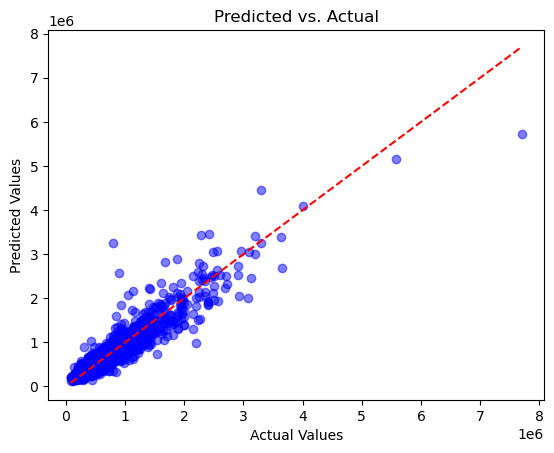

In [75]:
XGB1.evaluate_rmse()
XGB1.evaluate_r2()
XGB1.plot_model()

#### to save our best Model in a file called model.pkl

In [77]:
pickle.dump(XGB1.model, open('model.pkl','wb'))